# ECE480 Spoken Digit Recognition -- Development code

## Check-In #1

In [6]:
import numpy as np


def read_data(f:str, n_speakers:int, num_times:int=10) -> list[np.ndarray]:
    """
    Read data from the dataset.
    Data is formatted in blocks. Each block has 13 rows and ~30 columns.
    Blocks are separated by an empty row.
    Each column represents one of the 13 cepstral coefficients.
    Each block is a numpy array of shape (13, ~30).

    Parameters
    ----------
    f : str
        Path to the dataset.

    n_speakers : int
        Number of speakers whose voice is recorded in the dataset.

    num_times : int
        Number of times each speaker speaks a given number in the dataset.

    Returns
    -------
    data : list
        List of numpy arrays, where each element is a numpy array.
        [0, 1, 2, 3, 4, 5, 6, 7, 8, 9] # 10 digits
        |\
        | \
        [0, 1, 3, 4, 5, ..., 660]  # 660 = n_speakers * num_times
        |\
        | \
        np.array([[0, 1, 2, 3, 4, 5, ..., 13],
                  [0, 1, 2, 3, 4, 5, ..., 13],
                  ...
                  [0, 1, 2, 3, 4, 5, ..., 13]])  # 13 = number of cepstral coefficients, as many rows as there are frames (~30)
    """

    data = []  # Initialize an empty list to store the data
    current_digit_data = []  # Initialize a list to store data for the current digit
    current_block = []  # Initialize a list to store data for the current block

    with open(f, 'r') as file:
        for line in file:
            line = line.strip()
            if line:  # Non-empty line
                values = [float(value) for value in line.split()]  # Parse values from the line
                current_block.append(np.array(values).reshape(-1, 13))
            else:  # Empty line (block separator)
                to_add = np.array(current_block).reshape(-1, 13)
                current_digit_data.append(to_add)
                current_block = []  # Reset the current block
                if len(current_digit_data) == n_speakers * num_times:
                    data.append(current_digit_data)
                    current_digit_data = []  # Reset the current_digit_data, move on to the next digit

        # Add last digit's data
        # Edge case: last digit's data is not added in the loop above
        current_digit_data.append(np.array(current_block).reshape(13, -1))
        data.append(current_digit_data)

    return data

In [7]:
TEST = read_data("data/Test_Arabic_Digit.txt", n_speakers=22)
print(f'Number of digitis in the test dataset: {len(TEST)}')
print(f'Total number of blocks in the test dataset: {sum([len(digit) for digit in TEST])}')
print(f'Number of blocks for each digit: {[len(digit) for digit in TEST]}')
print(f'Sample block shapes for each digit: {[digit[0].shape for digit in TEST]}')

Number of digitis in the test dataset: 10
Total number of blocks in the test dataset: 2200
Number of blocks for each digit: [220, 220, 220, 220, 220, 220, 220, 220, 220, 220]
Sample block shapes for each digit: [(28, 13), (31, 13), (36, 13), (41, 13), (37, 13), (34, 13), (50, 13), (39, 13), (46, 13), (36, 13)]


In [8]:
TRAIN = read_data("data/Train_Arabic_Digit.txt", n_speakers=66)
print(f'Number of digitis in the train dataset: {len(TRAIN)}')
print(f'Total number of blocks in the train dataset: {sum([len(digit) for digit in TRAIN])}')
print(f'Number of blocks for each digit: {[len(digit) for digit in TRAIN]}')
print(f'Sample block shapes for each digit: {[digit[0].shape for digit in TRAIN]}')

Number of digitis in the train dataset: 10
Total number of blocks in the train dataset: 6600
Number of blocks for each digit: [660, 660, 660, 660, 660, 660, 660, 660, 660, 660]
Sample block shapes for each digit: [(38, 13), (32, 13), (35, 13), (38, 13), (31, 13), (29, 13), (42, 13), (31, 13), (44, 13), (34, 13)]


In [9]:
from matplotlib import pyplot as plt
import matplotlib

matplotlib.rcParams["figure.dpi"] = 500
plt.style.use('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle')


# Create a list of 10 blocks, 1 for each digit
# Also trim to just first 3 columns
digits = [digit[0][:, :3] for digit in TRAIN]


# Plot the first 3 cepstral coefficients for each digit
# Should be 10 plots, each plot plotting 3 linspaces
fig, axs = plt.subplots(10, 1, figsize=(10, 20))
for i, digit in enumerate(digits):
    axs[i].plot(digits[i][:, 0], label='1st cepstral coefficient')
    axs[i].plot(digits[i][:, 1], label='2nd cepstral coefficient')
    axs[i].plot(digits[i][:, 2], label='3rd cepstral coefficient')
    axs[i].legend()
    axs[i].set_title(f'Digit {i}')

fig.tight_layout()
plt.show()

### b) For a single utterance of each digit (0 through 9), scatter plot MFCC1 vs MFCC2 (each analysis window a single point in the scatter plot), MFCC1 va MFCC3. and MFCC2 vs MFCC3. (10 plots, 1 for each digit).


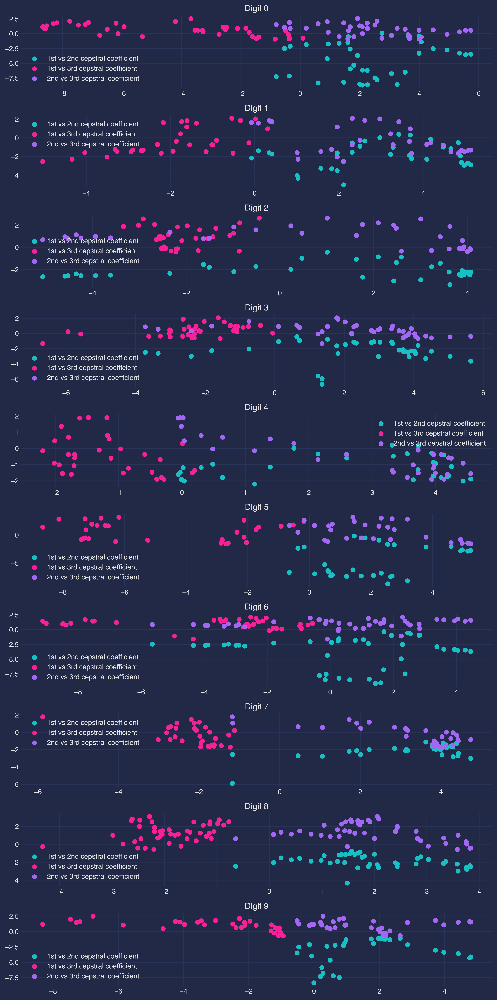

In [10]:
# Scatter plot 0 vs 1, 0 vs 2, 1 vs 2 for each digit

fig, axs = plt.subplots(10, 1, figsize=(10, 20))
for i in range(len(digits)):
    axs[i].scatter(digits[i][:, 0], digits[i][:, 1], label='1st vs 2nd cepstral coefficient')
    axs[i].scatter(digits[i][:, 1], digits[i][:, 2], label='1st vs 3rd cepstral coefficient')
    axs[i].scatter(digits[i][:, 0], digits[i][:, 2], label='2nd vs 3rd cepstral coefficient')
    axs[i].legend()
    axs[i].set_title(f'Digit {i}')

fig.tight_layout()
plt.show()

# Check-In #2

## a) For each digit (0 through 9), find the GMM representing that digit via K-Means and visualize the GMM by showing 3 contour plots of the pdf for 2 dimensions at a time: MFCC1 vs MFCC2, MFCC1 vs MFCC3. and MFCC2 vs MFCC3.3 (10 plots, 1 for each digit).

Let's apply a K-Means to the data above.

Except, we will now use all utterances of each digit, not just one.

In [11]:
from sklearn.cluster import KMeans
from scipy.stats import multivariate_normal

# We need to gather the points from all digits, not just the first one

# Make a list of all the digits -- i.e. append all utterances within each digit

# [---13---]
# |
# |
# |
# n_speakers * ~30 * 10
# |
# |
# |

to_append = []
for digit in TRAIN:
    digit_utterances = []
    for utterance in digit:
        if utterance.shape[1] == 13:
            digit_utterances.append(utterance)
    to_append.append(digit_utterances)

X_pre = [np.concatenate(to_append_digit, axis=0) for to_append_digit in to_append]

print([X.shape for X in X_pre])

fig, axs = plt.subplots(10, 3, figsize=(20, 40))

# For each digit
for i in range(10):

    X = X_pre[i]

    # Perform km clustering in 13 dimensions

    kmeans = KMeans(n_clusters=10, random_state=0).fit(X)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Get the cluster labels
    cluster_labels = kmeans.labels_


    # Approximate a GMM with 10 components using the cluster centers and cluster labels

    cluster_props = []
    cluster_means = []
    cluster_covs = []

    for j, c in enumerate(cluster_centers):
            # a) Find the proportion of observations in cluster m -- this is the probability of an observation coming from the mth GMM component
            cluster_prop = np.sum(cluster_labels == j) / len(cluster_labels)
            cluster_props.append(cluster_prop)
            # Find the sample mean of the observations in cluster m -- this is mean of the mth GMM component
            cluster_mean = np.mean(X[cluster_labels == j], axis=0)
            cluster_means.append(cluster_mean)
            # Find the sample covariance of the observations in cluster m -- this is the covariance of the mth GMM component
            cluster_cov = np.cov(X[cluster_labels == j], rowvar=False)
            cluster_covs.append(cluster_cov)

    # Make 10 sets of 3 plots, each set for a digit
    # Each set will have 3 plots, 1 for each pair of cepstral coefficients (0 vs 1, 0 vs 2, 1 vs 2)
    # Label the points with the cluster labels


    axs[i, 0].scatter(X[:, 0], X[:, 1], c=cluster_labels)
    axs[i, 0].set_xlabel('1st cepstral coefficient')
    axs[i, 0].set_ylabel('2nd cepstral coefficient')
    axs[i, 1].scatter(X[:, 1], X[:, 2], c=cluster_labels)
    axs[i, 1].set_xlabel('2nd cepstral coefficient')
    axs[i, 1].set_ylabel('3rd cepstral coefficient')
    axs[i, 2].scatter(X[:, 0], X[:, 2], c=cluster_labels)
    axs[i, 2].set_xlabel('1st cepstral coefficient')
    axs[i, 2].set_ylabel('3rd cepstral coefficient')
    axs[i, 0].set_title(f'Digit {i} 1st vs 2nd cepstral coefficient')
    axs[i, 1].set_title(f'Digit {i} 1st vs 3rd cepstral coefficient')
    axs[i, 2].set_title(f'Digit {i} 2nd vs 3rd cepstral coefficient')

    for cluster_mean, cluster_cov in zip(cluster_means, cluster_covs):
        # Plot the contour of the ith GMM component
        x, y = np.mgrid[-10:10:.01, -10:10:.01]
        pos = np.dstack((x, y))
        rv = multivariate_normal(cluster_mean[:2], cluster_cov[:2, :2])
        axs[i, 0].contour(x, y, rv.pdf(pos))
        rv = multivariate_normal(cluster_mean[1:3], cluster_cov[1:3, 1:3])
        axs[i, 1].contour(x, y, rv.pdf(pos))
        rv = multivariate_normal(cluster_mean[[0, 2]], cluster_cov[[0, 2], [0, 2]])
        axs[i, 2].contour(x, y, rv.pdf(pos))

fig.tight_layout()
plt.show()


[(23344, 13), (22652, 13), (27938, 13), (29406, 13), (27555, 13), (21631, 13), (28991, 13), (24924, 13), (32860, 13), (23923, 13)]


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KeyboardInterrupt: 

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "/Users/michaelbryant/Library/Python/3.11/lib/python/site-packages/numpy/core/multiarray.py", line 346, in where
    @array_function_from_c_func_and_dispatcher(_multiarray_umath.where)
    
KeyboardInterrupt: 
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


## Check-In #3

### a) Pick your favorite digit between 0 and 9. For the digit you select, find a GMM for that digit by estimating the GMM parameters from the cluster memberships identified by K-Means. You choose what assumptions, if any, you wish to place on the covariance matrices.

i. Tell us what digit you selected.

ii. Tell us your assumption regarding the number of mixture components.

iii. Tell us what assumptions you placed on your covariance matrices.

iv. Provide the parameters for your GMM – for each mixture component m, provide the mixture component probability $π_m$, the mixture component mean $μ_m$, and the mixture component covariance matrix $Σ_m$.

Digit selected: 2

Number of mixture components: see below

Covariance matrix: no assumption for now

(27938, 13)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.1

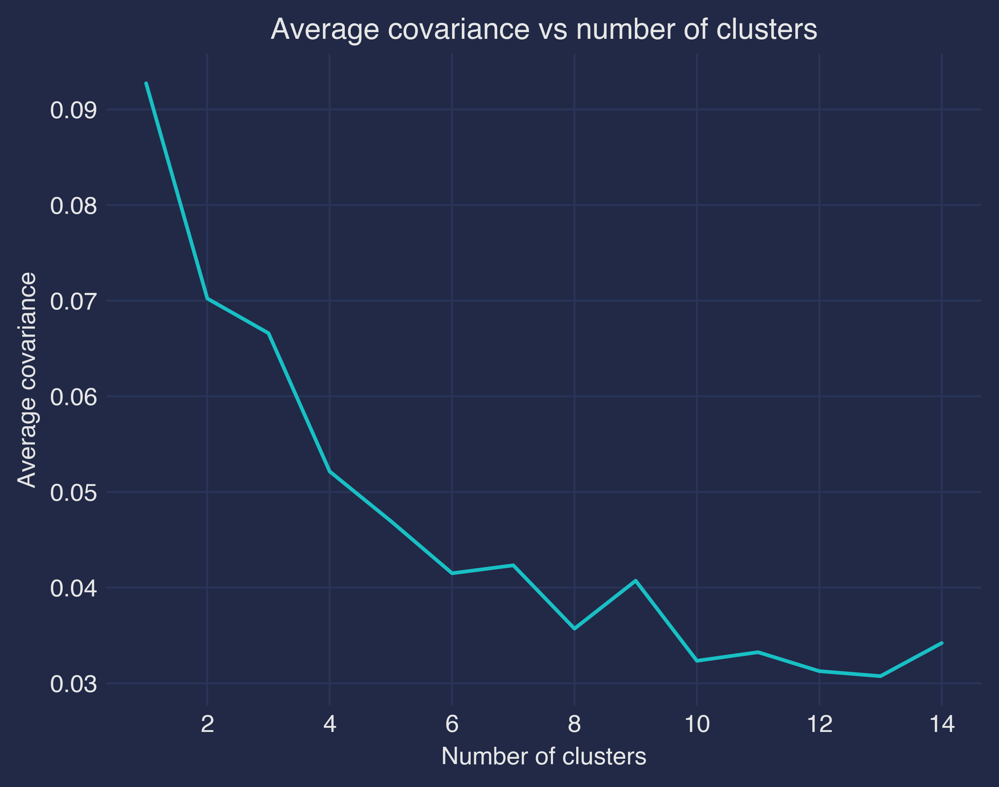

In [ ]:
# Place aggregate of all data for the digit 2 in X (13 dimensional space)
# Run k-means clustering on X with 10 clusters
# Get the cluster centers and covariances to estimate the GMM

number = 2

X = X_pre[number]
print(X.shape)

avg_cov_vals = []
means = []
covs = []
props = []

for num_clusters in range(1,15):

    kmeans = KMeans(n_clusters=num_clusters, random_state=42).fit(X)

    # Get the cluster centers
    cluster_centers = kmeans.cluster_centers_

    # Get the cluster labels
    cluster_labels = kmeans.labels_

    # Approximate a GMM
    cluster_props = []
    cluster_means = []
    cluster_covs = []

    for j, c in enumerate(cluster_centers):
        # a) Find the proportion of observations in cluster m -- this is the probability of an observation coming from the mth GMM component
        cluster_props.append(np.sum(cluster_labels == j) / len(cluster_labels))
        # Find the sample mean of the observations in cluster m -- this is mean of the mth GMM component
        cluster_means.append(cluster_centers[j])
        # Find the sample covariance of the observations in cluster m -- this is the covariance of the mth GMM component
        cluster_cov = np.cov(X[cluster_labels == j], rowvar=False)
        cluster_covs.append(cluster_cov)

    # Add the mean covariance over all variables to the list
    avg_cov_vals.append(np.mean([np.mean(cluster_cov) for cluster_cov in cluster_covs]))

    # Add the cluster means and covariances to the list
    means.append(cluster_means)
    covs.append(cluster_covs)
    props.append(cluster_props)

# Plot the average covariance values for each number of clusters
plt.plot(range(1,15), avg_cov_vals)
plt.xlabel('Number of clusters')
plt.ylabel('Average covariance')
plt.title('Average covariance vs number of clusters')
plt.show()


As can be seen, with more clusters, the covariances generally decrease. However, we do not want to overfit the data, so we will choose 8 clusters as this seems to be the closet representation of the "knee" in the graph.

In [ ]:
import pandas as pd

num_clusters = 8

# The desired means
mean = np.array(means[num_clusters - 1])

# The desired covariances
cov = np.array(covs[num_clusters - 1])

# The desired mixture component probabilities
prop = np.array(props[num_clusters - 1])

# Means is a 8 x 13 matrix
# Each of the 8 clusters has a mean vector of 13 dimensions
print(mean.shape)

# Covs is a 8 x 13 x 13 matrix
# Each of the 8 clusters has a covariance matrix of 13 x 13 dimensions
print(cov.shape)

# Props is a 8 dimensional vector
# Each of the 8 clusters has a probability of being chosen
print(prop.shape)

print()
print('Means')

# Display the matrices as dataframes
mean_df = pd.DataFrame(mean)

# Set the column names
mean_df.columns = [f'CC {i}' for i in range(1, 14)]

# Set the row names
mean_df.index = [f'Cluster {i}' for i in range(1, num_clusters + 1)]

# Round all values to 3 decimal places
mean_df = mean_df.round(3)

# Display the dataframe
display(mean_df)

# Now to make 8 dataframes for the covariances

print('Covariances')

for i in range(num_clusters):
    cov_df = pd.DataFrame(cov[i])

    # Set the column names
    cov_df.columns = [f'CC {i}' for i in range(1, 14)]

    # Set the row names
    cov_df.index = [f'CC {i}' for i in range(1, 14)]

    # Round all values to 3 decimal places
    cov_df = cov_df.round(3)

    # Display the dataframe
    display(cov_df)

print()
print('Mixture Compoenent Probabilities')

# Display the mixture component probabilities
props_df = pd.DataFrame(prop)

# Set the column names
props_df.index = [f'Cluster {i}' for i in range(1, num_clusters + 1)]

# # Set the row names
props_df.columns = ['Probability']

# Round all values to 3 decimal places
props_df = props_df.round(3)

# Add total probability
props_df.loc['Total'] = props_df.sum()

# Display the dataframe
display(props_df)



(8, 13)
(8, 13, 13)
(8,)

Means


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
Cluster 1,1.076,-0.861,2.008,0.604,-0.669,-0.912,-0.416,-1.340,0.018,-0.594,-0.331,-0.069,-0.188
Cluster 2,3.856,-1.053,-0.715,-0.875,-1.005,-0.840,-0.915,0.350,-0.118,-0.713,-0.779,-0.189,-0.220
Cluster 3,-4.654,-2.640,0.720,0.263,0.425,0.222,0.238,-0.007,0.261,0.282,0.449,0.346,0.111
Cluster 4,4.787,-5.217,-1.897,-1.592,-2.021,-0.954,-0.192,-0.179,-1.336,-0.800,-0.362,-0.562,-0.295
Cluster 5,2.604,-3.795,2.351,0.465,-2.529,-1.238,-0.955,-1.149,-0.610,-0.081,-0.211,-0.092,-0.274
Cluster 6,-1.475,-2.966,1.246,0.345,0.038,-0.152,-0.157,-0.693,0.136,-0.086,0.015,0.169,-0.119
Cluster 7,2.774,-2.985,-1.037,-1.630,-1.554,-1.393,-0.154,-0.304,-1.179,-1.085,-0.369,-0.645,-0.486
Cluster 8,1.235,-2.316,1.007,-0.591,-1.450,-1.565,-0.675,-1.585,-0.415,-0.831,-0.020,-0.128,-0.169


Covariances


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,1.180,0.399,0.070,0.156,-0.168,-0.224,-0.055,-0.032,-0.188,0.075,-0.061,0.001,0.015
CC 2,0.399,1.544,-0.038,-0.046,0.017,0.035,0.138,0.417,-0.007,0.205,-0.076,0.198,0.130
CC 3,0.070,-0.038,0.548,0.218,-0.062,-0.068,-0.044,-0.248,-0.016,0.049,0.080,-0.028,-0.047
CC 4,0.156,-0.046,0.218,0.682,0.113,-0.024,-0.051,-0.124,-0.064,0.115,0.036,0.017,-0.002
CC 5,-0.168,0.017,-0.062,0.113,0.562,0.221,-0.027,0.119,0.088,0.040,-0.083,0.077,-0.029
CC 6,-0.224,0.035,-0.068,-0.024,0.221,0.410,0.092,0.136,0.096,0.017,-0.090,0.074,0.042
CC 7,-0.055,0.138,-0.044,-0.051,-0.027,0.092,0.270,0.171,-0.006,0.017,0.001,0.041,0.062
CC 8,-0.032,0.417,-0.248,-0.124,0.119,0.136,0.171,0.824,0.017,0.120,-0.059,0.124,0.135
CC 9,-0.188,-0.007,-0.016,-0.064,0.088,0.096,-0.006,0.017,0.274,0.001,-0.055,-0.011,-0.026
CC 10,0.075,0.205,0.049,0.115,0.040,0.017,0.017,0.120,0.001,0.258,0.039,0.038,0.032


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,1.668,0.298,-0.329,0.183,-0.159,0.059,-0.161,0.116,-0.061,0.051,-0.157,0.088,-0.038
CC 2,0.298,1.348,0.387,-0.014,0.184,-0.065,0.076,-0.202,0.011,-0.005,-0.108,0.048,0.020
CC 3,-0.329,0.387,1.028,-0.093,0.105,-0.176,0.018,-0.072,0.030,0.074,0.052,0.095,-0.081
CC 4,0.183,-0.014,-0.093,0.897,-0.217,-0.036,0.002,0.064,-0.113,0.070,0.133,0.084,0.060
CC 5,-0.159,0.184,0.105,-0.217,0.360,0.060,-0.026,-0.075,0.051,0.047,-0.112,-0.002,0.021
CC 6,0.059,-0.065,-0.176,-0.036,0.060,0.624,-0.097,0.130,0.159,-0.019,-0.098,-0.014,0.094
CC 7,-0.161,0.076,0.018,0.002,-0.026,-0.097,0.342,-0.016,0.022,-0.041,0.070,-0.011,-0.037
CC 8,0.116,-0.202,-0.072,0.064,-0.075,0.130,-0.016,0.336,0.057,0.005,0.036,0.068,-0.037
CC 9,-0.061,0.011,0.030,-0.113,0.051,0.159,0.022,0.057,0.301,0.036,-0.010,-0.053,-0.012
CC 10,0.051,-0.005,0.074,0.070,0.047,-0.019,-0.041,0.005,0.036,0.290,-0.006,-0.036,0.041


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,0.889,-0.116,-0.008,-0.043,-0.105,-0.117,-0.146,-0.194,-0.080,-0.086,-0.066,-0.046,-0.103
CC 2,-0.116,0.198,0.019,0.044,0.010,0.015,0.020,-0.004,0.027,-0.004,0.002,0.004,0.005
CC 3,-0.008,0.019,0.107,0.060,0.021,0.012,-0.016,-0.050,0.018,0.005,0.011,0.022,-0.019
CC 4,-0.043,0.044,0.060,0.136,0.090,0.069,-0.044,-0.054,0.053,-0.002,-0.058,0.034,-0.045
CC 5,-0.105,0.010,0.021,0.090,0.176,0.118,-0.021,0.022,0.066,0.011,-0.108,0.039,-0.039
CC 6,-0.117,0.015,0.012,0.069,0.118,0.119,0.042,0.074,0.076,0.004,-0.102,0.003,-0.006
CC 7,-0.146,0.020,-0.016,-0.044,-0.021,0.042,0.174,0.186,0.051,0.021,0.004,-0.064,0.084
CC 8,-0.194,-0.004,-0.050,-0.054,0.022,0.074,0.186,0.261,0.085,0.038,-0.036,-0.068,0.105
CC 9,-0.080,0.027,0.018,0.053,0.066,0.076,0.051,0.085,0.123,0.026,-0.086,-0.011,0.033
CC 10,-0.086,-0.004,0.005,-0.002,0.011,0.004,0.021,0.038,0.026,0.066,0.077,0.041,0.033


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,0.765,-0.534,0.121,0.003,-0.084,0.055,0.025,0.032,-0.007,0.066,-0.047,0.003,0.026
CC 2,-0.534,1.657,-0.362,0.382,-0.061,-0.107,-0.278,0.022,-0.142,-0.242,-0.096,0.054,-0.232
CC 3,0.121,-0.362,1.058,0.031,-0.316,0.061,0.020,0.118,0.142,0.281,-0.091,-0.023,-0.032
CC 4,0.003,0.382,0.031,0.422,-0.129,0.004,-0.120,0.049,0.014,0.057,-0.043,0.036,-0.117
CC 5,-0.084,-0.061,-0.316,-0.129,0.727,0.010,-0.048,0.035,-0.158,-0.283,0.103,0.071,-0.015
CC 6,0.055,-0.107,0.061,0.004,0.010,0.275,0.012,-0.015,-0.004,0.019,-0.017,0.018,-0.003
CC 7,0.025,-0.278,0.020,-0.120,-0.048,0.012,0.344,-0.081,0.115,0.102,-0.018,-0.099,0.078
CC 8,0.032,0.022,0.118,0.049,0.035,-0.015,-0.081,0.325,-0.050,0.037,-0.041,0.006,-0.092
CC 9,-0.007,-0.142,0.142,0.014,-0.158,-0.004,0.115,-0.050,0.328,0.190,0.040,-0.044,0.021
CC 10,0.066,-0.242,0.281,0.057,-0.283,0.019,0.102,0.037,0.190,0.468,0.005,-0.019,-0.036


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,1.124,-0.212,-0.160,0.044,-0.356,-0.079,-0.064,0.093,-0.158,-0.040,-0.053,-0.030,0.056
CC 2,-0.212,1.596,-0.111,0.541,-0.099,0.003,0.063,0.148,-0.241,-0.107,0.102,-0.272,0.139
CC 3,-0.160,-0.111,0.765,-0.171,0.020,0.071,-0.090,-0.140,0.074,0.010,-0.044,0.091,-0.104
CC 4,0.044,0.541,-0.171,1.580,0.226,0.050,0.075,0.172,-0.361,0.107,0.176,-0.189,0.239
CC 5,-0.356,-0.099,0.020,0.226,0.939,-0.070,0.145,0.016,0.012,0.048,0.074,0.049,-0.045
CC 6,-0.079,0.003,0.071,0.050,-0.070,0.484,-0.066,0.159,-0.019,0.003,0.026,-0.011,0.073
CC 7,-0.064,0.063,-0.090,0.075,0.145,-0.066,0.332,0.056,0.014,0.034,0.003,0.019,0.019
CC 8,0.093,0.148,-0.140,0.172,0.016,0.159,0.056,0.591,-0.133,0.026,0.068,-0.021,0.190
CC 9,-0.158,-0.241,0.074,-0.361,0.012,-0.019,0.014,-0.133,0.342,-0.025,-0.012,0.099,-0.081
CC 10,-0.040,-0.107,0.010,0.107,0.048,0.003,0.034,0.026,-0.025,0.218,-0.008,0.041,-0.003


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,1.002,-0.225,0.159,0.004,-0.051,-0.059,-0.020,0.009,-0.038,-0.032,-0.102,-0.056,-0.018
CC 2,-0.225,1.453,0.044,0.244,-0.135,-0.060,-0.105,-0.352,0.112,-0.193,-0.110,-0.054,-0.082
CC 3,0.159,0.044,0.535,0.210,0.027,-0.013,-0.083,-0.138,0.049,-0.035,-0.063,-0.012,-0.051
CC 4,0.004,0.244,0.210,0.688,0.128,0.064,-0.173,-0.229,0.098,-0.095,-0.116,-0.028,-0.078
CC 5,-0.051,-0.135,0.027,0.128,0.452,0.219,0.004,0.085,0.083,0.004,-0.162,0.045,-0.058
CC 6,-0.059,-0.060,-0.013,0.064,0.219,0.282,0.068,0.112,0.083,-0.008,-0.145,0.021,-0.029
CC 7,-0.020,-0.105,-0.083,-0.173,0.004,0.068,0.269,0.239,0.032,0.049,-0.006,-0.020,0.061
CC 8,0.009,-0.352,-0.138,-0.229,0.085,0.112,0.239,0.512,0.039,0.139,-0.018,-0.013,0.096
CC 9,-0.038,0.112,0.049,0.098,0.083,0.083,0.032,0.039,0.241,0.023,-0.092,-0.008,-0.006
CC 10,-0.032,-0.193,-0.035,-0.095,0.004,-0.008,0.049,0.139,0.023,0.196,0.109,0.039,0.048


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,0.600,-0.077,-0.301,0.064,-0.014,0.066,-0.120,0.068,-0.072,-0.052,-0.077,-0.006,-0.112
CC 2,-0.077,0.637,0.028,-0.051,0.037,-0.084,0.087,-0.029,0.087,-0.051,-0.047,-0.079,-0.069
CC 3,-0.301,0.028,0.726,-0.056,-0.174,-0.087,0.117,-0.067,0.121,0.081,0.015,-0.035,0.038
CC 4,0.064,-0.051,-0.056,0.289,0.012,0.031,-0.042,0.016,-0.013,-0.033,-0.033,-0.015,-0.041
CC 5,-0.014,0.037,-0.174,0.012,0.404,0.080,-0.109,0.064,-0.073,-0.098,-0.037,0.044,-0.028
CC 6,0.066,-0.084,-0.087,0.031,0.080,0.369,0.026,0.020,-0.060,-0.055,-0.071,-0.024,-0.082
CC 7,-0.120,0.087,0.117,-0.042,-0.109,0.026,0.379,-0.032,0.083,0.048,-0.016,-0.055,0.008
CC 8,0.068,-0.029,-0.067,0.016,0.064,0.020,-0.032,0.253,-0.011,-0.019,-0.039,-0.072,-0.093
CC 9,-0.072,0.087,0.121,-0.013,-0.073,-0.060,0.083,-0.011,0.320,0.086,0.021,-0.026,-0.016
CC 10,-0.052,-0.051,0.081,-0.033,-0.098,-0.055,0.048,-0.019,0.086,0.303,0.065,0.036,0.029


,CC 1,CC 2,CC 3,CC 4,CC 5,CC 6,CC 7,CC 8,CC 9,CC 10,CC 11,CC 12,CC 13
CC 1,0.795,0.059,-0.008,0.001,-0.068,-0.132,-0.080,-0.051,-0.059,-0.025,-0.118,-0.033,-0.120
CC 2,0.059,0.770,0.135,-0.071,0.008,-0.108,0.116,0.122,-0.009,-0.041,-0.042,-0.141,-0.167
CC 3,-0.008,0.135,0.489,0.157,-0.061,-0.013,-0.060,-0.093,0.086,0.039,-0.069,-0.074,-0.140
CC 4,0.001,-0.071,0.157,0.518,0.131,0.043,-0.141,-0.143,0.043,-0.010,-0.060,-0.049,-0.139
CC 5,-0.068,0.008,-0.061,0.131,0.412,0.114,-0.093,0.010,-0.022,-0.022,-0.050,0.058,-0.088
CC 6,-0.132,-0.108,-0.013,0.043,0.114,0.329,0.006,-0.064,0.045,-0.026,-0.053,0.045,0.001
CC 7,-0.080,0.116,-0.060,-0.141,-0.093,0.006,0.266,0.130,-0.024,0.002,0.027,-0.059,0.023
CC 8,-0.051,0.122,-0.093,-0.143,0.010,-0.064,0.130,0.495,-0.064,0.045,-0.001,-0.043,0.001
CC 9,-0.059,-0.009,0.086,0.043,-0.022,0.045,-0.024,-0.064,0.262,0.033,-0.066,-0.063,-0.046
CC 10,-0.025,-0.041,0.039,-0.010,-0.022,-0.026,0.002,0.045,0.033,0.250,0.120,0.011,0.020



Mixture Compoenent Probabilities


,Probability
Cluster 1,0.169
Cluster 2,0.148
Cluster 3,0.136
Cluster 4,0.096
Cluster 5,0.069
Cluster 6,0.105
Cluster 7,0.119
Cluster 8,0.158
Total,1.000


### b) Use this GMM for your favorite digit to find the likelihood for each utterance (every token for all 10 digits) for this model.

### Apply kernel density estimation to visualize the probability density function of the likelihoods for each digit individually. (You may find that visualizing the pdf of the log-likelihoods is easier to visually interpret.) 

### For example, take all of the utterances for the digit ’0’ and find their likelihoods under your GMM. Visualize the pdf of the likelihoods for ’0’. Then take all of the utterances for the digit ’1’ and find their likelihoods under your GMM. Visualize the pdf of the likelihoods for ’1’. (10 pdfs, 1 for each digit’s utterances)

Likelihoods shape: (23344,)
Predicted mean for digit 0: -18.773956077160527


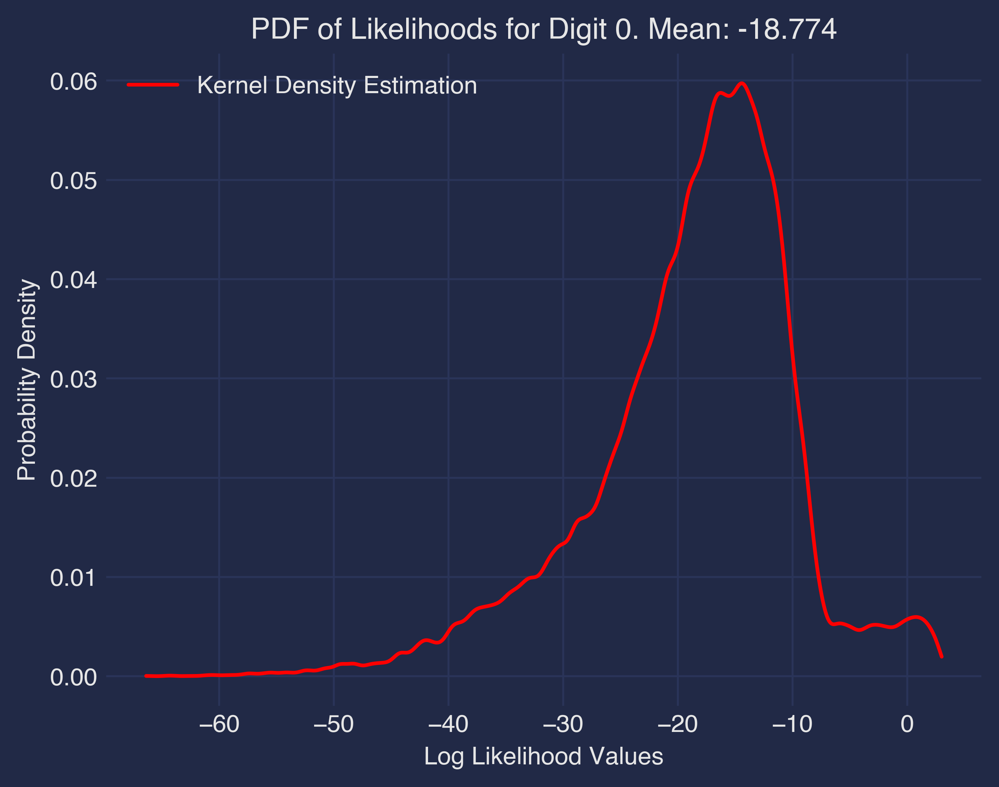

Likelihoods shape: (22652,)
Predicted mean for digit 1: -21.428847583923126


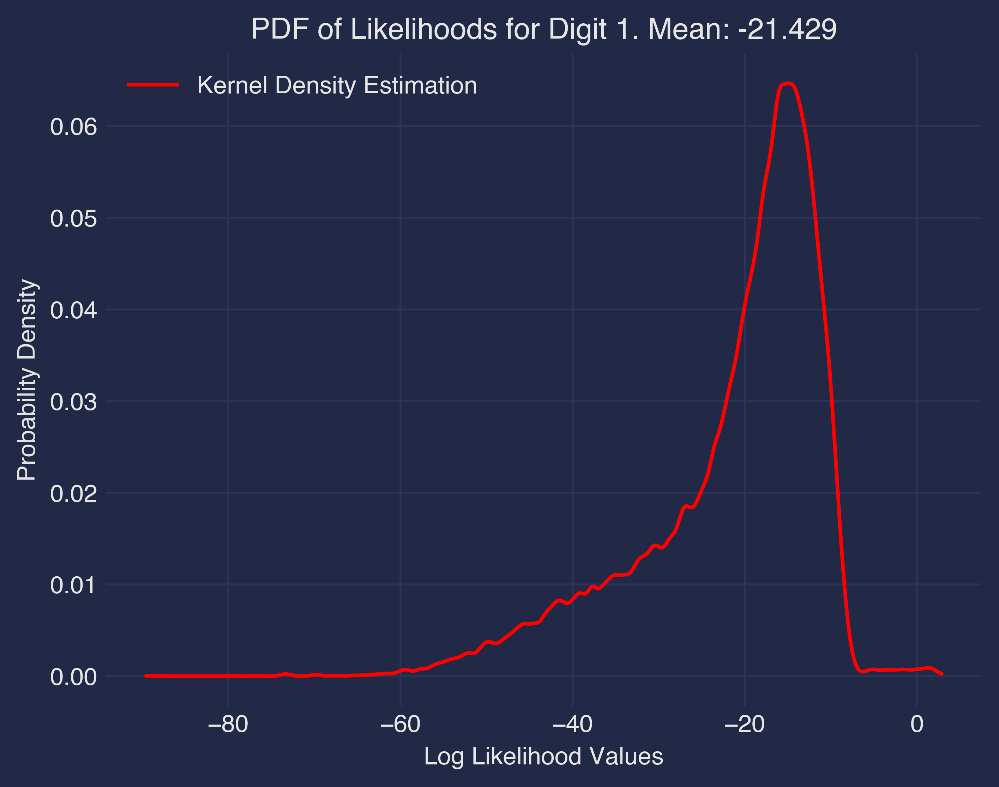

Likelihoods shape: (27938,)
Predicted mean for digit 2: -11.537409146861933


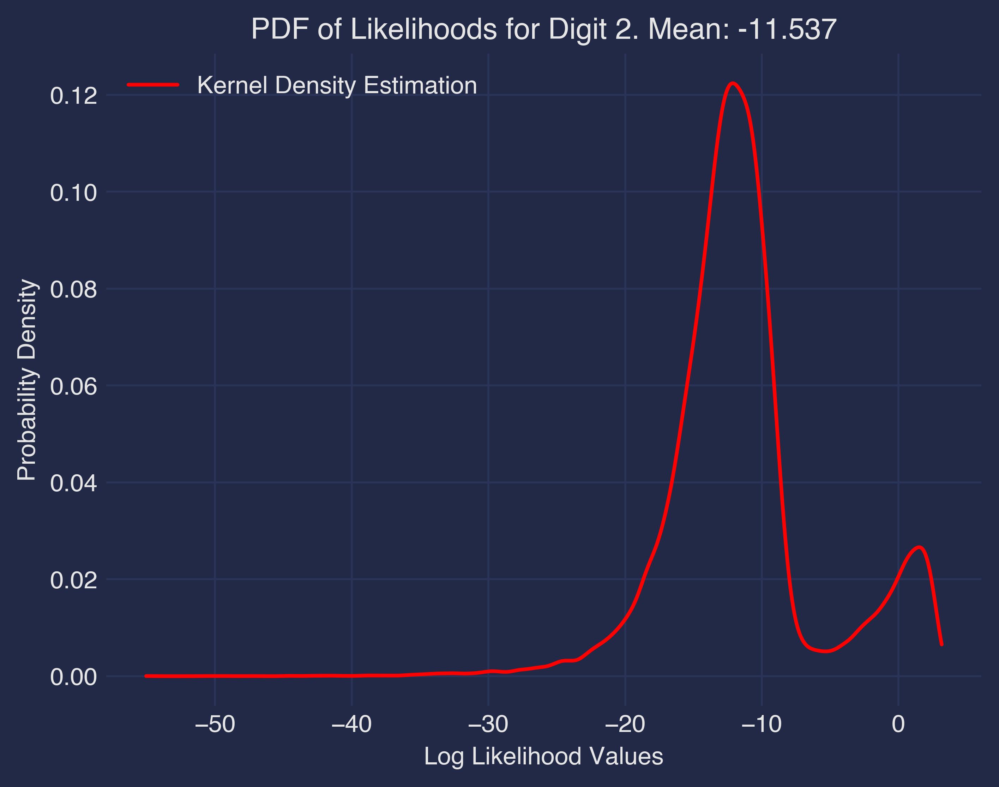

Likelihoods shape: (29406,)
Predicted mean for digit 3: -15.391080753905198


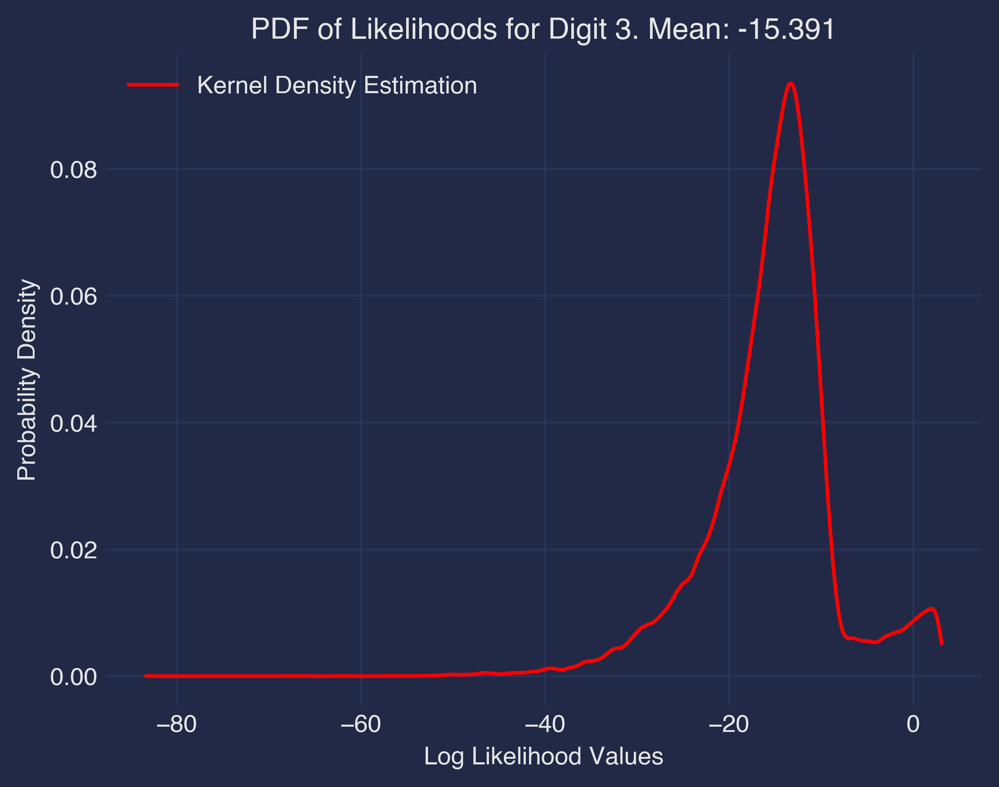

Likelihoods shape: (27555,)
Predicted mean for digit 4: -22.880713812326885


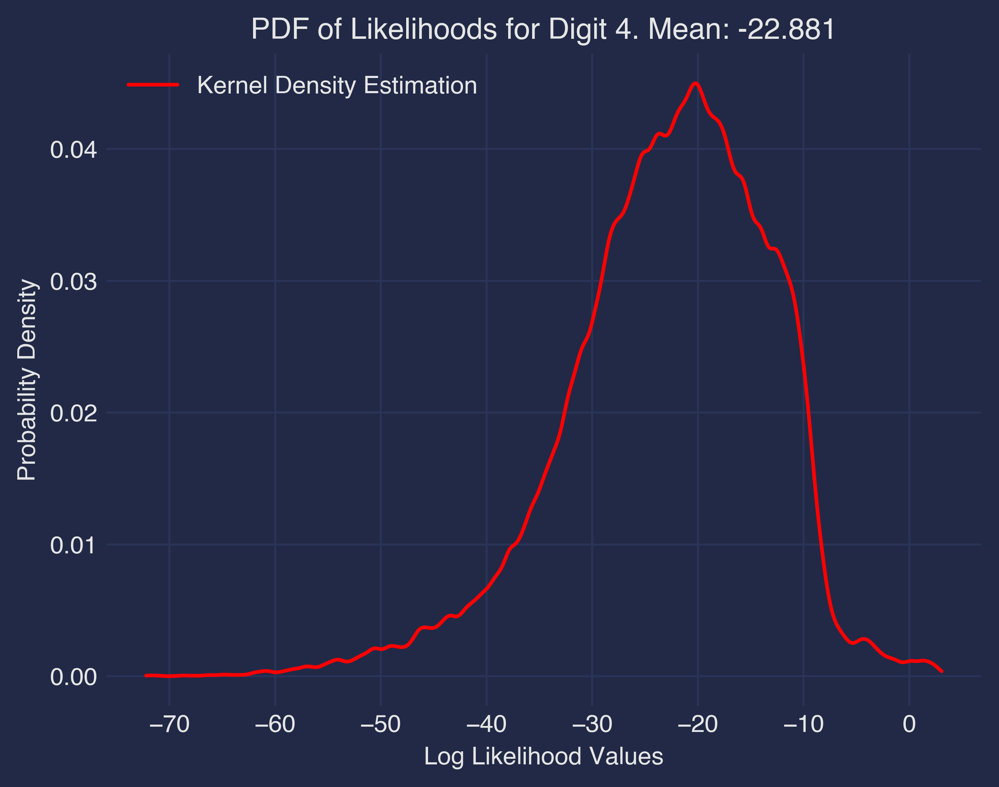

Likelihoods shape: (21631,)
Predicted mean for digit 5: -20.233760574319746


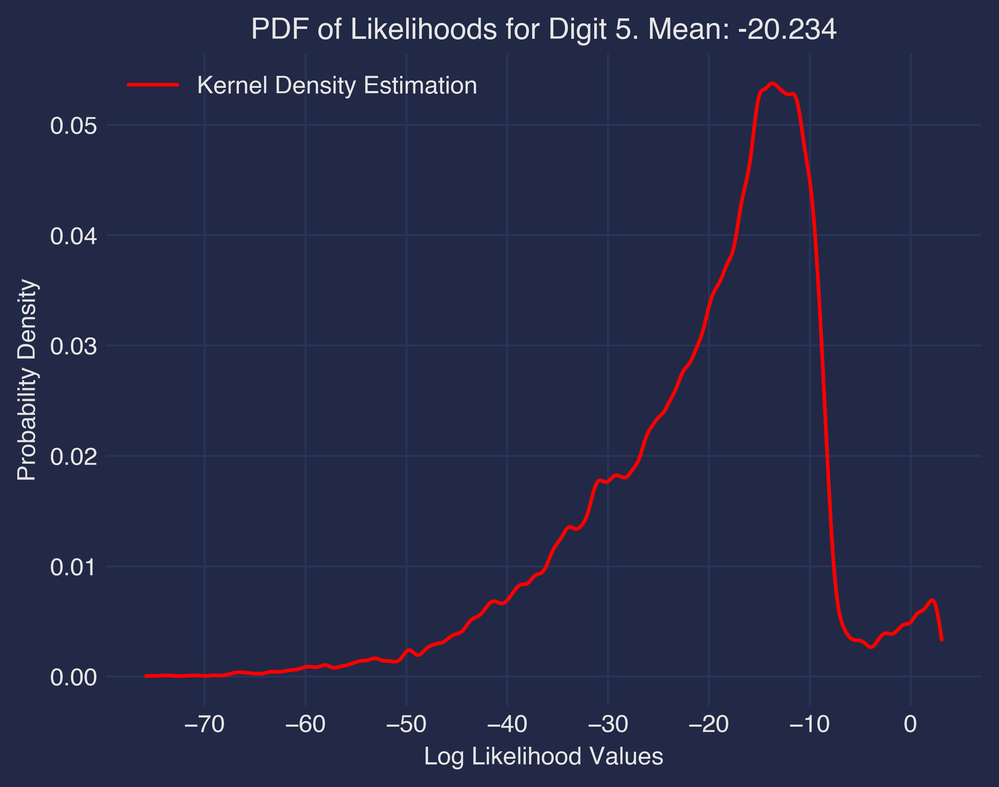

Likelihoods shape: (28991,)
Predicted mean for digit 6: -16.16458238255506


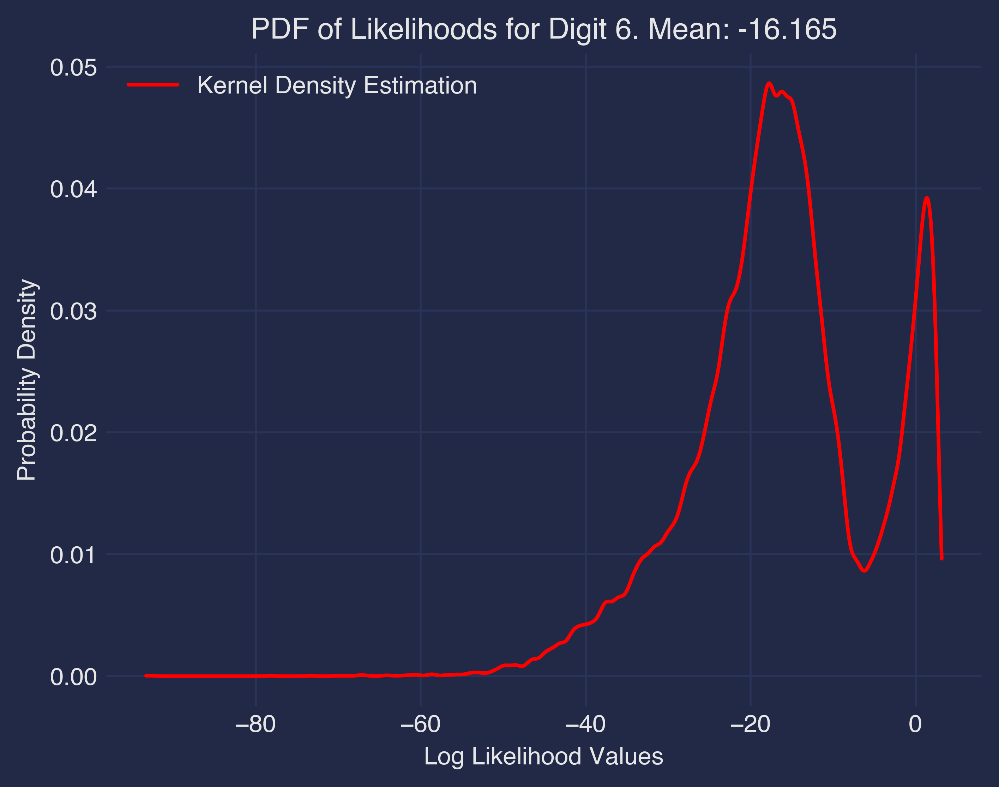

Likelihoods shape: (24924,)
Predicted mean for digit 7: -21.441660275709072


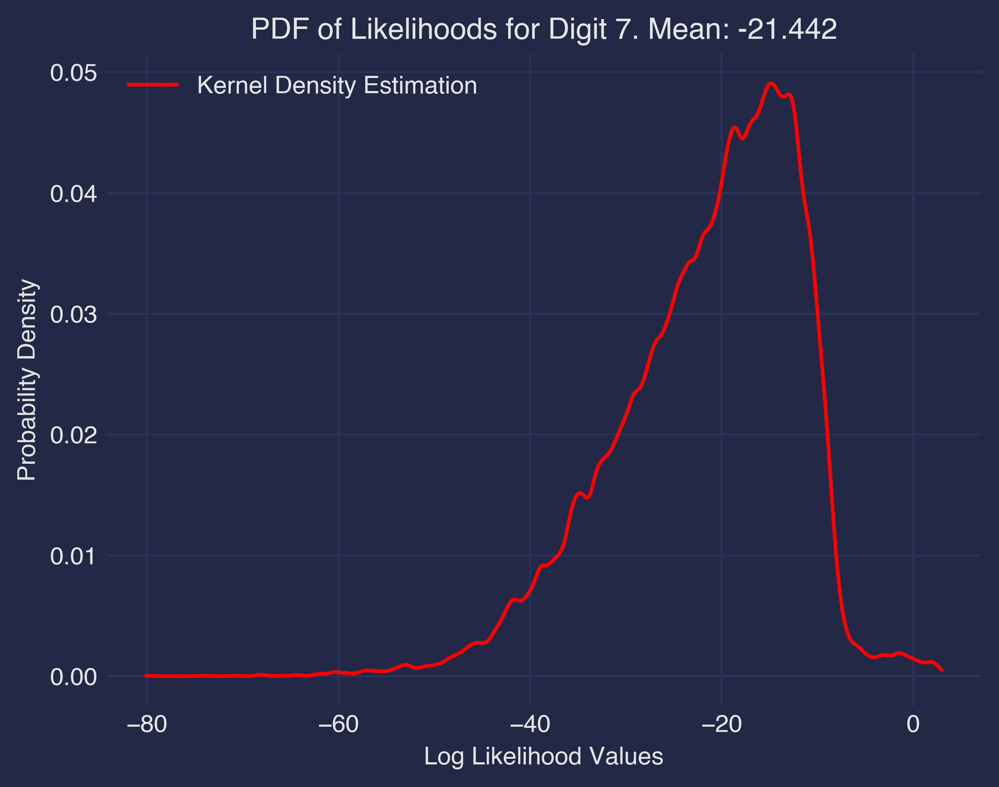

Likelihoods shape: (32860,)
Predicted mean for digit 8: -14.293996755709598


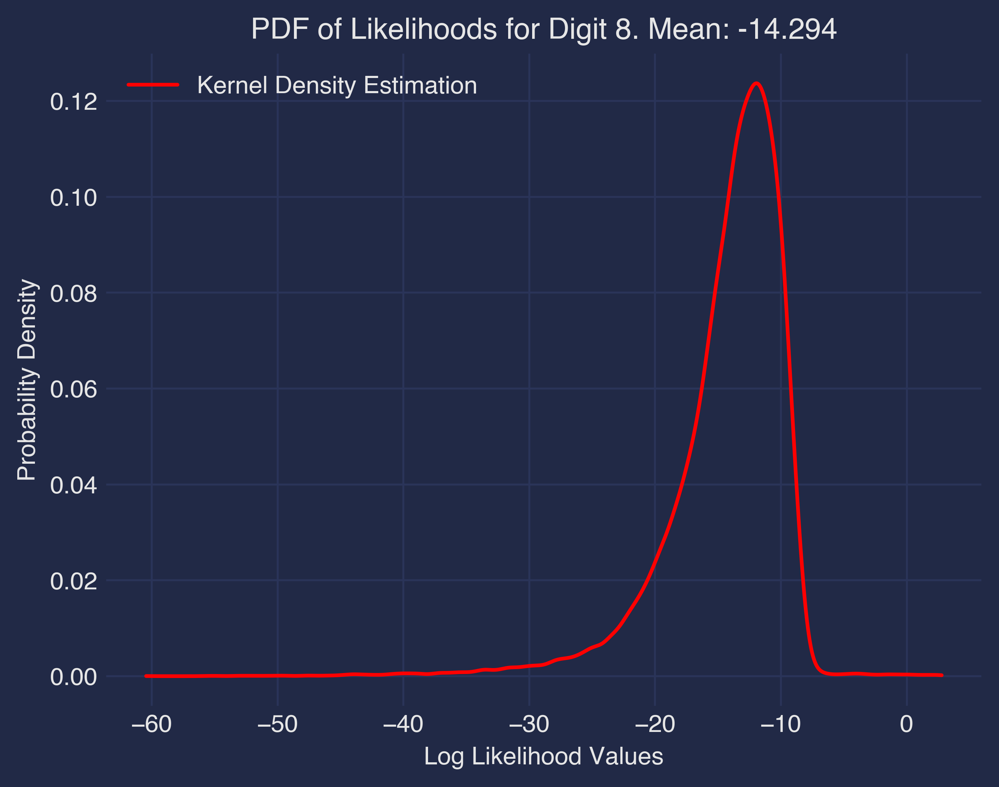

Likelihoods shape: (23923,)
Predicted mean for digit 9: -19.89173229308051


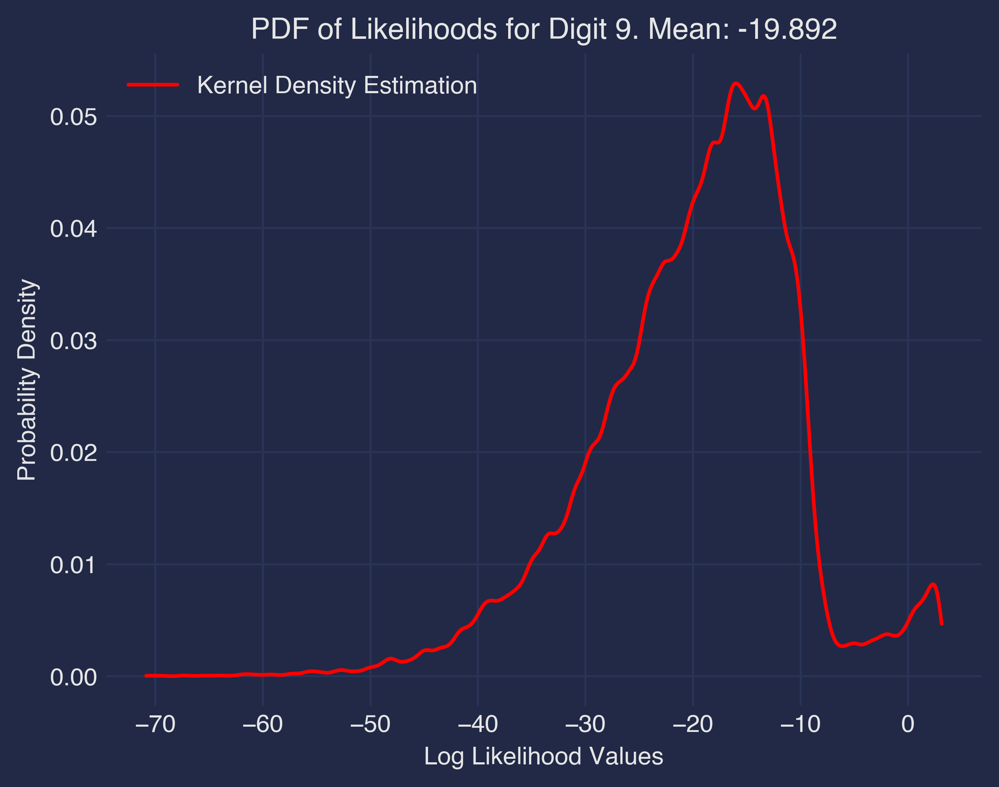

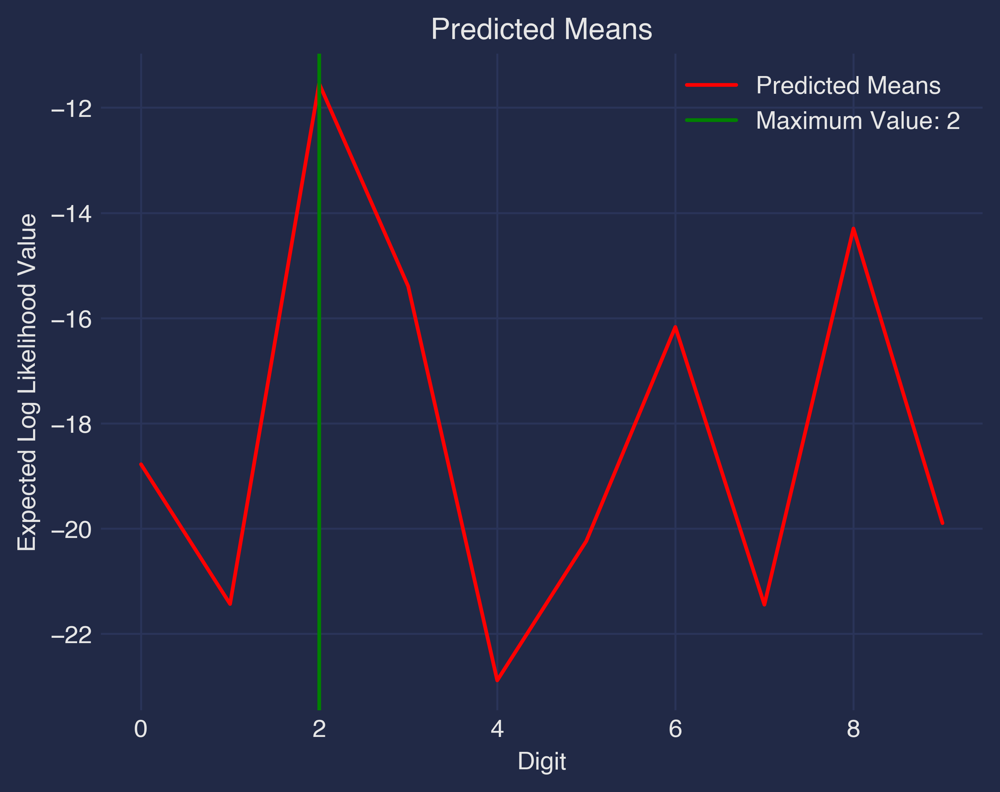

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
from sklearn.neighbors import KernelDensity


# Create an instance of KernelDensity
kde = KernelDensity(bandwidth=0.5)  # Adjust the bandwidth as needed

predicted_means = []

# Loop through each digit
for digit in range(10):

    X = X_pre[digit]

    # Calculate the log likelihood for each utterance under the multivariate normal distribution
    likelihoods = np.zeros(len(X))

    for i in range(num_clusters):
        # Calculate likelihood for each cluster
        cluster_mean = mean[i]
        cluster_cov = cov[i]
        cluster_likelihoods = multivariate_normal.pdf(X, mean=cluster_mean, cov=cluster_cov) * prop[i]

        # Accumulate the likelihoods for each cluster
        likelihoods += cluster_likelihoods

    # Take the log of the likelihoods
    likelihoods = np.log(likelihoods)

    # Print shape of likelihoods
    print(f'Likelihoods shape: {likelihoods.shape}')

    # Estimate the PDF of the likelihoods using KernelDensity
    kde.fit(likelihoods.reshape(-1, 1))
    x_values = np.linspace(min(likelihoods), max(likelihoods), 1000).reshape(-1, 1)
    pdf_values = kde.score_samples(x_values)

    # Print the mean values
    predicted_mean = np.mean(likelihoods)
    predicted_means.append(predicted_mean)
    print(f'Predicted mean for digit {digit}: {predicted_mean}')

    # Plot the histogram
    plt.figure()

    # Plot the estimated PDF
    plt.plot(x_values, np.exp(pdf_values), color='red', label='Kernel Density Estimation')

    plt.title(f'PDF of Likelihoods for Digit {digit}. Mean: {predicted_mean:.3f}')
    plt.xlabel('Log Likelihood Values')
    plt.ylabel('Probability Density')
    plt.legend()
    plt.show()

# Plot the predicted means
plt.figure()
plt.plot(range(10), predicted_means, color='red', label='Predicted Means')
plt.title('Predicted Means')
plt.xlabel('Digit')
plt.ylabel('Expected Log Likelihood Value')

# Draw a vertical line at the maximum value
plt.axvline(np.argmax(predicted_means), color='green', label=f'Maximum Value: {np.argmax(predicted_means)}')

plt.legend()
plt.show()

## Check-In #4

### a) For each digit (0 through 9), find the GMM representing that digit via Expectation-Maximization and visualize the GMM by showing 3 contour plots of the pdf for 2 dimensions at a time: MFCC1 vs MFCC2, MFCC1 va MFCC3. and MFCC2 vs MFCC3.3 (10 plots, 1 for each digit).


In [ ]:
from sklearn.mixture import GaussianMixture

# Make our GMM for each number

GMMs = []

for number in range(10):

    X = X_pre[number]
    print(X.shape)

    gmm = GaussianMixture(n_components=num_clusters, random_state=42).fit(X)

    GMMs.append(gmm)
        

(23344, 13)
(22652, 13)
(27938, 13)
(29406, 13)
(27555, 13)
(21631, 13)
(28991, 13)
(24924, 13)
(32860, 13)
(23923, 13)


In [ ]:
fig, axs = plt.subplots(10, 3, figsize=(20, 40))

# For each digit
for i in range(10):

    gmm = GMMs[i]

    # Make 10 sets of 3 plots, each set for a digit
    # Each set will have 3 plots, 1 for each pair of cepstral coefficients (0 vs 1, 0 vs 2, 1 vs 2)
    # Label the points with the cluster labels

    axs[i, 0].scatter(X[:, 0], X[:, 1], c=gmm.predict(X))
    axs[i, 0].set_xlabel('1st cepstral coefficient')
    axs[i, 0].set_ylabel('2nd cepstral coefficient')
    axs[i, 1].scatter(X[:, 1], X[:, 2], c=gmm.predict(X))
    axs[i, 1].set_xlabel('2nd cepstral coefficient')
    axs[i, 1].set_ylabel('3rd cepstral coefficient')
    axs[i, 2].scatter(X[:, 0], X[:, 2], c=gmm.predict(X))
    axs[i, 2].set_xlabel('1st cepstral coefficient')
    axs[i, 2].set_ylabel('3rd cepstral coefficient')
    axs[i, 0].set_title(f'Digit {i} 1st vs 2nd cepstral coefficient')
    axs[i, 1].set_title(f'Digit {i} 1st vs 3rd cepstral coefficient')
    axs[i, 2].set_title(f'Digit {i} 2nd vs 3rd cepstral coefficient')

    for cluster_mean, cluster_cov in zip(gmm.means_, gmm.covariances_):
        # Plot the contour of the ith GMM component
        x, y = np.mgrid[-10:10:.01, -10:10:.01]
        pos = np.dstack((x, y))
        rv = multivariate_normal(cluster_mean[:2], cluster_cov[:2, :2])
        r = rv.pdf(pos)
        r[r < 0.01] = 0
        axs[i, 0].contour(x, y, r)
        rv = multivariate_normal(cluster_mean[1:3], cluster_cov[1:3, 1:3])
        r = rv.pdf(pos)
        r[r < 0.01] = 0
        axs[i, 1].contour(x, y, r)
        rv = multivariate_normal(cluster_mean[[0, 2]], cluster_cov[[0, 2], [0, 2]])
        r = rv.pdf(pos)
        r[r < 0.01] = 0
        axs[i, 2].contour(x, y, r)

fig.tight_layout()
plt.show()
